# Exploratory Data Analysis

## Initial View

This dataset reflects reported incidents of crime (with the exception of murders where data exists for each victim) that occurred in the City of Chicago in the last year, minus the most recent seven days. Data is extracted from the Chicago Police Department's [CLEAR](https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-present-Dashboard/5cd6-ry5g) (Citizen Law Enforcement Analysis and Reporting) system. In order to protect the privacy of crime victims, addresses are shown at the block level only and specific locations are not identified.

For the purposes of this project only data from 2022 is being used. It should also be noted that not all the original features are included in the sample dataset used for this project.

### Goal

Load the data and review the column types to ensure that they are all the correct type and determine if any of the feature has missing data.

In [1]:
import pandas as pd

# Use the inline backend to generate the plots within the browser
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns

sns.set_style("darkgrid")

font = {"size": 12}
mpl.rc("font", **font)

# Use Folium to display the Maps for Visualisation
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import plugins

import jupyter_black

jupyter_black.load()

In [2]:
df = pd.read_csv("./raw_data.csv", parse_dates=["Date"])

### Clean Column Names

Convert to lowercase and replace spaces with under scores.

In [3]:
df.columns = [col.lower().replace(" ", "_") for col in df.columns]

In [4]:
df.head().T

,0,1,2,3,4
case_number,JF442145,JF448734,JF440254,JF441499,JF441193
date,2022-10-19 22:00:00,2022-09-17 23:00:00,2022-10-19 08:40:00,2022-10-19 00:00:00,2022-10-19 10:30:00
block,023XX W 21ST ST,019XX N SEMINARY AVE,092XX S COLFAX AVE,006XX W WALNUT ST,014XX N MAGNOLIA AVE
iucr,0810,0810,031A,1320,0810
primary_type,THEFT,THEFT,ROBBERY,CRIMINAL DAMAGE,THEFT
description,OVER $500,OVER $500,ARMED - HANDGUN,TO VEHICLE,OVER $500
location_description,VEHICLE NON-COMMERCIAL,STREET,SIDEWALK,STREET,PARKING LOT / GARAGE (NON RESIDENTIAL)
arrest,False,False,False,False,False
domestic,False,False,False,False,False
beat,1234,1811,423,1214,1433


## Describe the Features

| Column Name   | Type          | Description                                            | 
| :------------ | :------------ | :----------------------------------------------------- | 
| case_number | Object (Str)   | The Chicago Police Department RD Number (Records Division Number), which is unique to the incident. |
| date          | Date & Time   | Date when the incident occurred. This is sometimes a best estimate. |
| block         | Object (Str)  | The partially redacted address where the incident occurred, placing it on the same block as the actual address. |
| iucr          | Object (Str)  | The Illinois Unifrom Crime Reporting code. This is directly linked to the Primary Type and Description. See the list of IUCR codes at https://data.cityofchicago.org/d/c7ck-438e. |
| primary_type   | Object (Str)  | The primary description of the IUCR code. |
| description   | Object (Str)  | The secondary description of the IUCR code, a subcategory of the primary description. |
| location_description | Object (Str)  | Description of the location where the incident occurred. |
| arrest        | Boolean      | Indicates whether an arrest was made. |
| domentic      | Boolean      | Indicates whether the incident was domestic-related as defined by the Illinois Domestic Violence Act. |
| beat          | Number | Indicates the beat where the incident occurred. A beat is the smallest police geographic area – each beat has a dedicated police beat car. Three to five beats make up a police sector, and three sectors make up a police district. The Chicago Police Department has 22 police districts. See the beats at https://data.cityofchicago.org/d/aerh-rz74. |
| district  | Number | The district (City Council district) where the incident occurred. See the districts at https://data.cityofchicago.org/Public-Safety/Boundaries-Police-Districts-current-/fthy-xz3r. |
| ward      | Number | The ward (City Council district) where the incident occurred. See the wards at https://data.cityofchicago.org/d/sp34-6z76. |
| community_area      | Number | Indicates the community area where the incident occurred. Chicago has 77 community areas. See the community areas at https://data.cityofchicago.org/d/cauq-8yn6. |
| fbi_code      | Object (Str)  | Indicates the crime classification as outlined in the FBI's National Incident-Based Reporting System (NIBRS). See the Chicago Police Department listing of these classifications at http://gis.chicagopolice.org/clearmap_crime_sums/crime_types.html. |
| lattitude    | Float        | The latitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block. |
| longitude    | Float        | The longitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block. |

### Check for Null / Empty Values

If there are any rows with empty values we will drop those rows as we have no way of determining what their true value should be.

In [5]:
df.isna().sum()

case_number                0
date                       0
block                      0
iucr                       0
primary_type               0
description                0
location_description     514
arrest                     0
domestic                   0
beat                       0
district                   0
ward                      10
community_area             0
fbi_code                   0
latitude                1385
longitude               1385
dtype: int64

In [6]:
# Reset index after drop
df = df.dropna().reset_index(drop=True)

### Correct Data Type if required

In [7]:
df.dtypes

case_number                     object
date                    datetime64[ns]
block                           object
iucr                            object
primary_type                    object
description                     object
location_description            object
arrest                            bool
domestic                          bool
beat                             int64
district                       float64
ward                           float64
community_area                 float64
fbi_code                        object
latitude                       float64
longitude                      float64
dtype: object

In [8]:
# Some Floats should be integers
df.district = df.district.astype(int)
df.ward = df.ward.astype(int)
df.community_area = df.community_area.astype(int)

In [9]:
df.dtypes

case_number                     object
date                    datetime64[ns]
block                           object
iucr                            object
primary_type                    object
description                     object
location_description            object
arrest                            bool
domestic                          bool
beat                             int64
district                         int64
ward                             int64
community_area                   int64
fbi_code                        object
latitude                       float64
longitude                      float64
dtype: object

### Generated Featured

The date field, by itself, would not be veery predictive. The date field will be split into the following fields:

* `day_of_week`: The day of week the crime occured
* `hour`: The hour when the crime happened.

Breaking down into minutes is probably too fine a detail. For Visual Analysis some other fields are added.

Block is split into the partial zip code and the street name.

In [10]:
df["hour"] = df["date"].dt.hour
df["day_name"] = df["date"].dt.day_name()
df["day"] = df["date"].dt.dayofweek + 1
df["month_name"] = df["date"].dt.month_name()
df["month"] = df["date"].dt.month
df["year"] = df["date"].dt.year
df["year_month"] = df["date"].dt.to_period("M")

In [11]:
df["zip"] = df.block.str.split(" ").str[0]
df["street"] = df.block.str.split(" ").str[1:].apply(", ".join)

In [12]:
df.head().T

,0,1,2,3,4
case_number,JF442145,JF440254,JF441499,JF441193,JF441291
date,2022-10-19 22:00:00,2022-10-19 08:40:00,2022-10-19 00:00:00,2022-10-19 10:30:00,2022-10-19 15:00:00
block,023XX W 21ST ST,092XX S COLFAX AVE,006XX W WALNUT ST,014XX N MAGNOLIA AVE,005XX N LA SALLE DR
iucr,0810,031A,1320,0810,0917
primary_type,THEFT,ROBBERY,CRIMINAL DAMAGE,THEFT,MOTOR VEHICLE THEFT
description,OVER $500,ARMED - HANDGUN,TO VEHICLE,OVER $500,"CYCLE, SCOOTER, BIKE WITH VIN"
location_description,VEHICLE NON-COMMERCIAL,SIDEWALK,STREET,PARKING LOT / GARAGE (NON RESIDENTIAL),STREET
arrest,False,False,False,False,False
domestic,False,False,False,False,False
beat,1234,423,1214,1433,1831


---
# Data Visualisation

To get a better understanding of the data we will now visualise it.

### Number of Crimes per month

Text(0.0, 1.0, 'Count of Cases Per Month')

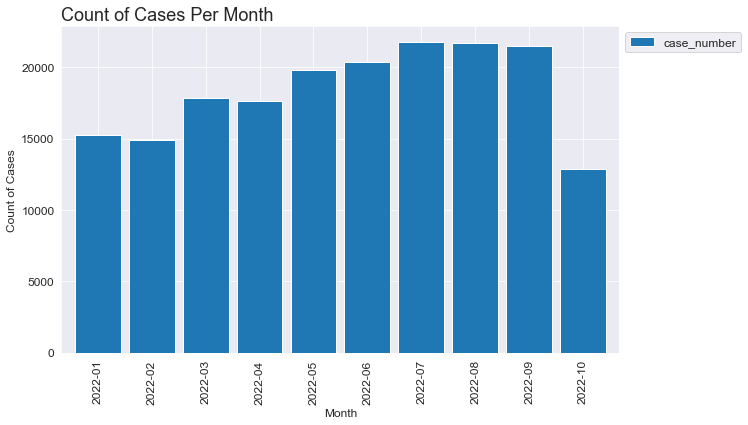

In [13]:
df.groupby("year_month").count().plot(
    y="case_number",
    kind="bar",
    figsize=(10, 6),
    width=0.85,
    fontsize=12,
    colormap="tab20",
).legend(bbox_to_anchor=(1, 1), prop={"size": 12})

plt.xlabel("Month")
plt.ylabel("Count of Cases")
plt.title("Count of Cases Per Month", loc="left", fontsize=18)

Unsuprisingly there little obvious variation in the number of crimes committed per month other than an apparent slow increase in offences as the COVID Pandemic came to an end. October is only a partial month. 

Text(0.0, 1.0, 'Count of Cases Per Month with Arrests')

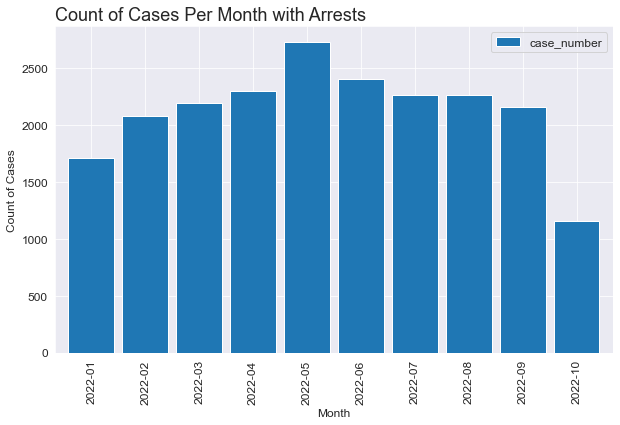

In [14]:
df[df["arrest"] == True].groupby("year_month").count().plot(
    y="case_number",
    kind="bar",
    figsize=(10, 6),
    width=0.85,
    fontsize=12,
    colormap="tab20",
).legend(bbox_to_anchor=(1, 1), prop={"size": 12})

plt.xlabel("Month")
plt.ylabel("Count of Cases")
plt.title("Count of Cases Per Month with Arrests", loc="left", fontsize=18)

Looking at cases where there was an arrest we can see that there was a spike in arrests in May. Given that there was an increase in crimes committed in the second half of the year the fact that the number of arrests fell could be considered disapointing.

### Number of crimes occuring on each day

Text(0.0, 1.0, 'Count of Cases Per Day of Week [1 is a Tuesday]')

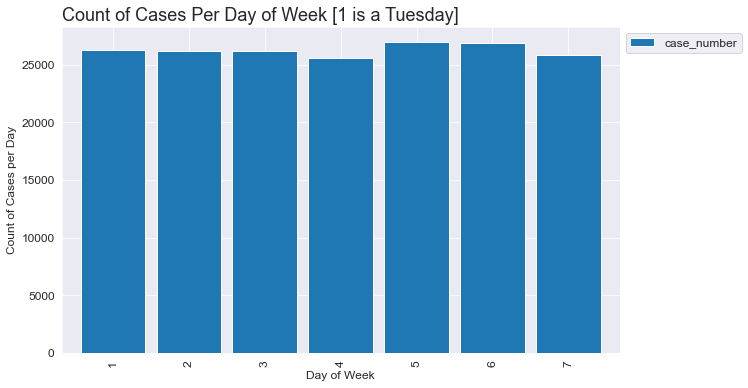

In [15]:
df.groupby("day").count().plot(
    y="case_number",
    kind="bar",
    figsize=(10, 6),
    width=0.85,
    fontsize=12,
    colormap="tab20",
).legend(bbox_to_anchor=(1, 1), prop={"size": 12})

plt.xlabel("Day of Week")
plt.ylabel("Count of Cases per Day")
plt.title("Count of Cases Per Day of Week [1 is a Tuesday]", loc="left", fontsize=18)

There is a small increase in crime reported at the weekend, Saturday and Sunday (days 5 and 6), but nothing that could be considered significant.

Text(0.0, 1.0, 'Count of Cases with Arrests Per Day of Week [1 is a Tuesday]')

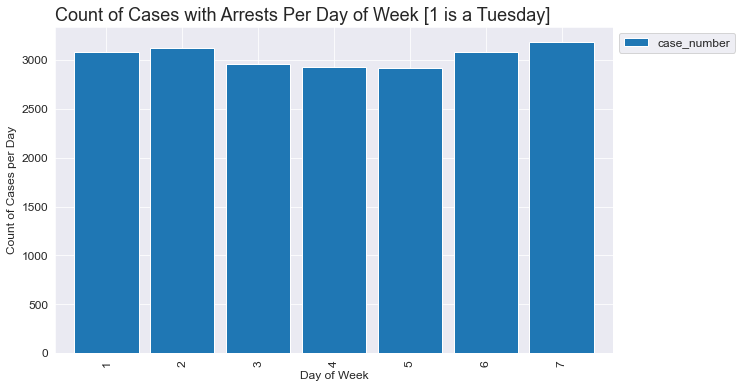

In [16]:
df[df["arrest"] == True].groupby("day").count().plot(
    y="case_number",
    kind="bar",
    figsize=(10, 6),
    width=0.85,
    fontsize=12,
    colormap="tab20",
).legend(bbox_to_anchor=(1, 1), prop={"size": 12})

plt.xlabel("Day of Week")
plt.ylabel("Count of Cases per Day")
plt.title(
    "Count of Cases with Arrests Per Day of Week [1 is a Tuesday]",
    loc="left",
    fontsize=18,
)

### Number of crimes occuring in each hour

Text(0.0, 1.0, 'Count of Cases Per Hour')

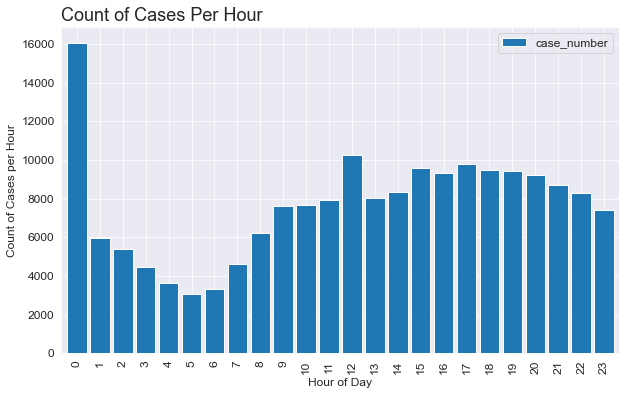

In [17]:
df.groupby("hour").count().plot(
    y="case_number",
    kind="bar",
    figsize=(10, 6),
    width=0.85,
    fontsize=12,
    colormap="tab20",
).legend(bbox_to_anchor=(1, 1), prop={"size": 12})

plt.xlabel("Hour of Day")
plt.ylabel("Count of Cases per Hour")
plt.title("Count of Cases Per Hour", loc="left", fontsize=18)

There is an expected fall-off in reported crime rates after midnight before elevating again after seven, eight in the morning. The spike in cases reports after midnight looks like it may be an error but, unfortunately, we have no way of verifying.

Text(0.0, 1.0, 'Count of Cases with Arrests Per Hour')

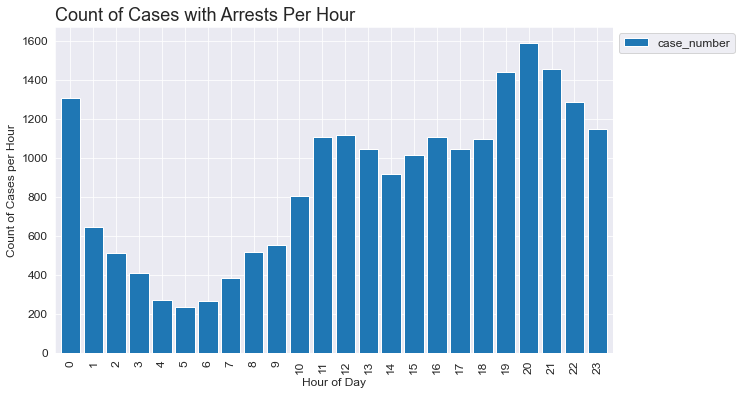

In [18]:
df[df["arrest"] == True].groupby("hour").count().plot(
    y="case_number",
    kind="bar",
    figsize=(10, 6),
    width=0.85,
    fontsize=12,
    colormap="tab20",
).legend(bbox_to_anchor=(1, 1), prop={"size": 12})

plt.xlabel("Hour of Day")
plt.ylabel("Count of Cases per Hour")
plt.title("Count of Cases with Arrests Per Hour", loc="left", fontsize=18)

The plot above shows that there is definitely some hours that appear to have more arrests than others. Let's look at the ratio of arrests to cases.

In [19]:
df_plt = df.groupby("hour").agg({"arrest": "sum", "case_number": "count"})
df_plt["average"] = df_plt["arrest"] / df_plt["case_number"] * 100

Text(0.0, 1.0, 'Count of Cases with Arrests Per Hour')

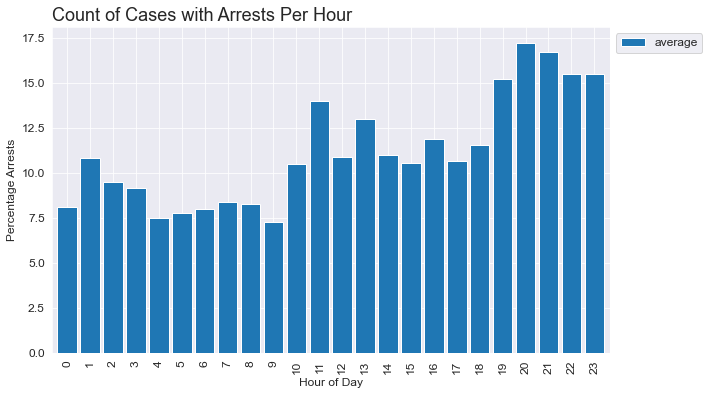

In [20]:
df_plt.plot(
    y="average",
    kind="bar",
    figsize=(10, 6),
    width=0.85,
    fontsize=12,
    colormap="tab20",
).legend(bbox_to_anchor=(1, 1), prop={"size": 12})

plt.xlabel("Hour of Day")
plt.ylabel("Percentage Arrests")
plt.title("Count of Cases with Arrests Per Hour", loc="left", fontsize=18)

It would appear that the highest arrest rates are for crimes reported after 18:00 hours.

### Correlation Matrix

Let's create a correlation Matrix to see which of the feature are correlated.

<AxesSubplot:>

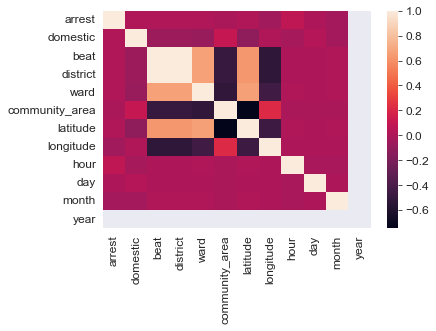

In [21]:
corr = df.corr()

# Display using Seaborn
sns.heatmap(
    corr,
    xticklabels=corr.columns.values,
    yticklabels=corr.columns.values,
)

The `beat`, `district`, `ward` and `community area` features are highly correlated and could be reduced to a single feature if processing time was a factor. `longitude` and `latitude` are also highly correlated but that is to be expected.

### Let's look at some Histograms

/var/folders/sp/2h0n9jbn0r9_6byxc4838g2m0000gn/T/ipykernel_76246/3224846326.py:26: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared.
  df.hist(bins=100, ax=ax, layout=(4, 3), column=numerical_columns)


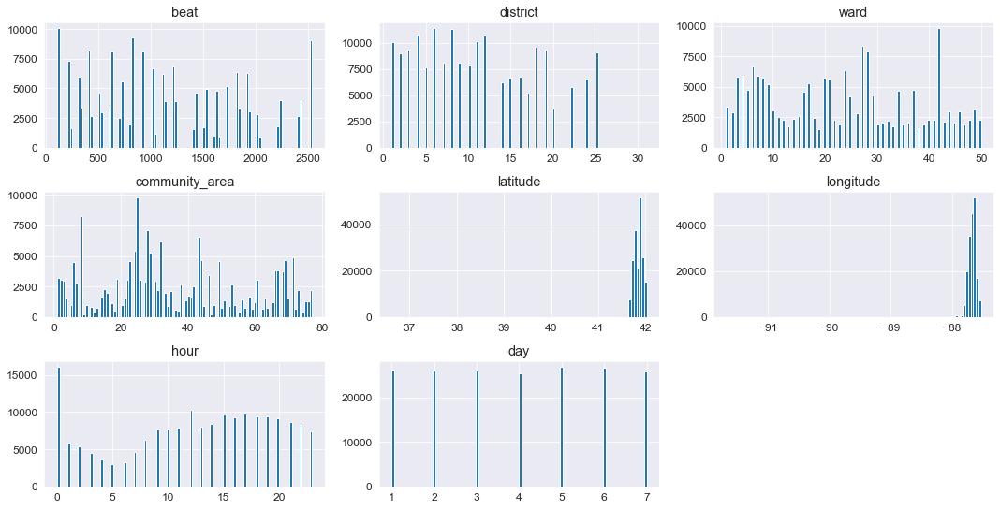

In [22]:
categorical_columns = [
    "iucr",
    "primary_type",
    "description",
    "location_description",
    "fbi_code",
    "zip",
    "street",
]

numerical_columns = [
    "domestic",
    "beat",
    "district",
    "ward",
    "community_area",
    "latitude",
    "longitude",
    "hour",
    "day",
]

# Inspecting data through Histograms:
fig = plt.figure(figsize=(15, 10))
ax = plt.gca()
df.hist(bins=100, ax=ax, layout=(4, 3), column=numerical_columns)
plt.tight_layout()
plt.show()

### Now let's look at the Crime Categories.

In [23]:
# Number of unique Crime categories bases on the Primary Description
df.primary_type.nunique()

31

In [24]:
# What Crimes are the 10 most commonly occuring ones
df[["primary_type", "case_number"]].groupby(
    ["primary_type"], as_index=False
).count().sort_values("case_number", ascending=False).head(10)

,primary_type,case_number
29,THEFT,42258
2,BATTERY,33155
5,CRIMINAL DAMAGE,21144
1,ASSAULT,16729
16,MOTOR VEHICLE THEFT,14363
22,OTHER OFFENSE,11680
8,DECEPTIVE PRACTICE,11020
30,WEAPONS VIOLATION,7271
26,ROBBERY,6851
3,BURGLARY,5894


In [25]:
# What Crimes are the 10 most commonly occuring ones that have an arrest
df_arrest = df[df.arrest == True].copy()
df_arrest[["primary_type", "case_number"]].groupby(
    ["primary_type"], as_index=False
).count().sort_values("case_number", ascending=False).head(10)

,primary_type,case_number
29,WEAPONS VIOLATION,4584
2,BATTERY,4540
16,NARCOTICS,3073
21,OTHER OFFENSE,1696
1,ASSAULT,1593
28,THEFT,1507
7,CRIMINAL TRESPASS,1000
5,CRIMINAL DAMAGE,705
15,MOTOR VEHICLE THEFT,357
25,ROBBERY,330


From the two table above we can see that even though theft and battery are the two most commonly occuring crimes, theft in particular does not have a very high arrest rate.

In order to get a better understanding of the top five crimes with arrests lets first create  smaller dataframe the only contains these top crimes. Next we'll visualise these crimes using area charts.

Text(0.0, 1.0, 'Count of Top 3 Cases Per Month')

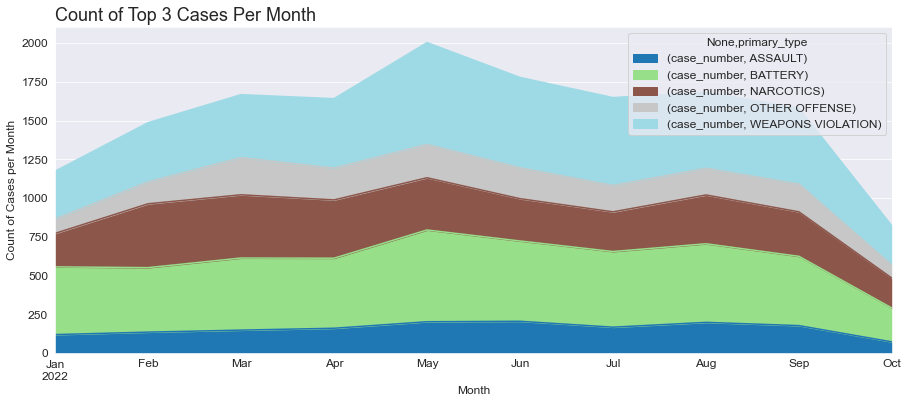

In [26]:
# Create a list of the 5 most commonly occuring crimes with Arrests
top_five_crimes = (
    df_arrest[["primary_type", "case_number"]]
    .groupby(["primary_type"])
    .count()
    .sort_values("case_number", ascending=False)[:5]
    .axes[0]
    .tolist()
)

# Create a new data frame with just the top 10 crimes
df_top5 = df_arrest[df_arrest["primary_type"].isin(top_five_crimes)].copy()

# Create a pivot area chart of the crimes per month
df_top5[["case_number", "primary_type", "year_month"]].pivot_table(
    index="year_month", columns="primary_type", fill_value=0, aggfunc="count"
).plot(kind="area", stacked=True, figsize=(15, 6), colormap="tab20")

plt.xlabel("Month")
plt.ylabel("Count of Cases per Month")
plt.title("Count of Top 3 Cases Per Month", loc="left", fontsize=18)

With a higher arrest rate for crime categories of Battery and Other Offence we would hope that we would be able to predict a higher arrest accuracy for these offenses.

### Create a folium map with a different colour per crime

Before we start modelling let's have a look and see if there are any patterns in the data when superposed on a map.

Colour each of the top 5 crimes with a different and plot on a Folium map.

In [27]:
# Create a list of 10 colours.
# We have  list of the top 10 crimes from earlier
colors5 = [
    "red",
    "green",
    "blue",
    "orange",
    "purple",
]

# Create a dictionary of colours to map to the crimes
dict_colours5 = dict(zip(top_five_crimes, colors5))

In [28]:
# Add the colours colums to the df_top5 DataFrame
df_top5["colour"] = df_top5.primary_type.map(dict_colours5)

Now that the dataframe of crimes with colour has been created all the remains is to generate the Folium Plots

#### Marker Map of the Top 5 Crimes in the month of September

In [29]:
# Define Chicago's geolocation coordinates
chicago_latitude = 41.85
chicago_longitude = -87.75

In [30]:
# Define the world map centered around Chicago with a higher zoom level
chicago_map = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=10)

# display world map
chicago_map

# Instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the August crimes and add each to the incidents feature group
for lat, lng, col in zip(df_top5.latitude, df_top5.longitude, df_top5.colour):
    incidents.add_child(
        folium.features.CircleMarker(
            [lat, lng],
            radius=1,  # define how big you want the circle markers to be
            color=col,
            fill=True,
            fill_color=col,
            fill_opacity=0.6,
        )
    )

# add incidents to map
chicago_map.add_child(incidents)

The map of the incident map for the top five crimes with arrests is not very enlightening. Next the same data was added to a Cluster Map.

In [31]:
mc = MarkerCluster()

# Define the world map centered around Chicago with a higher zoom level
chicago_cluster = folium.Map(
    location=[chicago_latitude, chicago_longitude], zoom_start=10
)

# display world map
chicago_cluster

# creating a Marker for each point in df_sample. Each point will get a popup with their zip
for row in df_top5.itertuples():
    mc.add_child(
        folium.Marker(location=[row.latitude, row.longitude], popup=row.primary_type)
    )

chicago_cluster.add_child(mc)
chicago_cluster

Several obvious clusters of crime locations with arrests were visible, particularly around Oak Park. Would arrest prediction be as accurate.

Finally a heat map of the crimes with arrests was created.

In [32]:
from folium import plugins
from folium.plugins import HeatMap

chicago_heatmat = folium.Map(
    location=[chicago_latitude, chicago_longitude], zoom_start=10
)

# List comprehension to make out list of lists
heat_data = [[row["latitude"], row["longitude"]] for index, row in df_top5.iterrows()]

# Plot it on the map
HeatMap(
    heat_data,
    min_opacity=0.5,
    max_zoom=18,
    radius=15,
    blur=20,
    gradient=None,
    overlay=True,
).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

This reinforces the cluster chart where it can clearly be seen that the area around Oak Park has a high crime arrest rate. It will be interesting to see later if there is a high probability of arrests in this areas once the model has been created.

# The Final Dataset

To reduce the size of the final dataset we will only use records for the top 5 crimes with the best arrest record.

In [33]:
df.dtypes

case_number                     object
date                    datetime64[ns]
block                           object
iucr                            object
primary_type                    object
description                     object
location_description            object
arrest                            bool
domestic                          bool
beat                             int64
district                         int64
ward                             int64
community_area                   int64
fbi_code                        object
latitude                       float64
longitude                      float64
hour                             int64
day_name                        object
day                              int64
month_name                      object
month                            int64
year                             int64
year_month                   period[M]
zip                             object
street                          object
dtype: object

In [34]:
cols_to_keep = [
    "block",
    "iucr",
    "primary_type",
    "description",
    "location_description",
    "arrest",
    "domestic",
    "beat",
    "district",
    "ward",
    "community_area",
    "fbi_code",
    "latitude",
    "longitude",
    "hour",
    "day",
    "zip",
    "street",
]

In [35]:
df_final = df[cols_to_keep].copy()

In [36]:
df_final.shape

(183688, 18)

In [37]:
# Create a new data frame with just the top 10 crimes
df_final = df_final[df_final["primary_type"].isin(top_five_crimes)].copy()

In [38]:
df

,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,...,longitude,hour,day_name,day,month_name,month,year,year_month,zip,street
0,JF442145,2022-10-19 22:00:00,023XX W 21ST ST,0810,THEFT,OVER $500,VEHICLE NON-COMMERCIAL,False,False,1234,...,-87.683955,22,Wednesday,3,October,10,2022,2022-10,023XX,"W, 21ST, ST"
1,JF440254,2022-10-19 08:40:00,092XX S COLFAX AVE,031A,ROBBERY,ARMED - HANDGUN,SIDEWALK,False,False,423,...,-87.560853,8,Wednesday,3,October,10,2022,2022-10,092XX,"S, COLFAX, AVE"
2,JF441499,2022-10-19 00:00:00,006XX W WALNUT ST,1320,CRIMINAL DAMAGE,TO VEHICLE,STREET,False,False,1214,...,-87.644677,0,Wednesday,3,October,10,2022,2022-10,006XX,"W, WALNUT, ST"
3,JF441193,2022-10-19 10:30:00,014XX N MAGNOLIA AVE,0810,THEFT,OVER $500,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,1433,...,-87.659465,10,Wednesday,3,October,10,2022,2022-10,014XX,"N, MAGNOLIA, AVE"
4,JF441291,2022-10-19 15:00:00,005XX N LA SALLE DR,0917,MOTOR VEHICLE THEFT,"CYCLE, SCOOTER, BIKE WITH VIN",STREET,False,False,1831,...,-87.632570,15,Wednesday,3,October,10,2022,2022-10,005XX,"N, LA, SALLE, DR"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183683,JF420478,2022-09-01 05:00:00,005XX W SURF ST,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,RESIDENCE,False,True,1934,...,-87.641485,5,Thursday,4,September,9,2022,2022-09,005XX,"W, SURF, ST"
183684,JF420319,2022-07-08 00:00:00,114XX S PRAIRIE AVE,1130,DECEPTIVE PRACTICE,FRAUD OR CONFIDENCE GAME,STREET,False,False,531,...,-87.616813,0,Friday,5,July,7,2022,2022-07,114XX,"S, PRAIRIE, AVE"
183685,JF420102,2022-09-27 11:00:00,023XX E 70TH ST,0810,THEFT,OVER $500,RESIDENCE,False,False,331,...,-87.567453,11,Tuesday,2,September,9,2022,2022-09,023XX,"E, 70TH, ST"
183686,JF420427,2022-09-03 10:25:00,052XX W CARMEN AVE,2021,NARCOTICS,POSSESS - BARBITURATES,RESIDENCE - YARD (FRONT / BACK),True,False,1623,...,-87.758535,10,Saturday,6,September,9,2022,2022-09,052XX,"W, CARMEN, AVE"


In [39]:
df_final.to_csv("./final_data.csv", index=False)